In [3]:
import numpy as np 
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, StratifiedKFold
from wordcloud import WordCloud
%matplotlib inline

import utils_binary as utils

In [2]:
# get data
# class_dict = {'01.예진':0,
#             '02.초진':1,
#             '03.투약및검사':2,
#             '04.검사결과설명및퇴실':3}
class_dict = {'KTAS3':0,
                'KTAS4,5':1}
n_class = len(class_dict)

## Setting default path
path_dataDF = os.path.join(os.path.abspath('..'), '..', '00_NIA_Emergency', 'data')
df_all = utils.preprocessing_data2morph(path_dataDF, class_dict)

n KTAS3: 753 case
n KTAS4,5: 295 case
Loading context done!


In [6]:
import random

df_class1 = df_all.loc[df_all['class']==1]
df_class0 = df_all.loc[df_all['class']==0]
print(len(df_class0))
print(len(df_class1))
random.seed(10)
rnd_index = random.sample(range(len(df_class0)),len(df_class1))
print(rnd_index)
print(len(rnd_index))
df_class0 = df_class0.iloc[rnd_index]
print(len(df_class0))
df_concat = pd.concat([df_class0, df_class1], axis=0).reset_index()
print(df_concat)

753
295
[585, 33, 439, 494, 591, 15, 211, 473, 503, 284, 669, 164, 35, 533, 501, 335, 77, 255, 369, 45, 430, 142, 617, 363, 390, 431, 290, 691, 268, 467, 178, 702, 310, 677, 371, 136, 723, 245, 450, 628, 384, 733, 596, 4, 241, 137, 199, 720, 549, 374, 715, 321, 682, 562, 461, 446, 481, 66, 668, 598, 332, 513, 160, 229, 422, 244, 37, 32, 508, 308, 621, 673, 73, 546, 82, 153, 393, 580, 383, 615, 719, 115, 98, 452, 170, 195, 357, 443, 424, 456, 251, 281, 146, 632, 534, 182, 122, 273, 466, 309, 168, 722, 180, 491, 355, 737, 445, 689, 5, 557, 44, 339, 327, 248, 81, 724, 458, 414, 710, 162, 399, 507, 247, 537, 278, 532, 749, 616, 511, 64, 694, 738, 472, 410, 139, 732, 554, 693, 666, 551, 397, 700, 169, 572, 451, 101, 425, 36, 2, 449, 548, 695, 51, 358, 94, 155, 111, 464, 496, 731, 469, 697, 725, 457, 351, 265, 592, 433, 336, 627, 535, 157, 243, 330, 751, 200, 490, 25, 119, 303, 646, 252, 296, 91, 47, 563, 108, 292, 166, 488, 144, 734, 619, 196, 599, 186, 638, 706, 436, 212, 670, 315, 474, 65

In [12]:
configs = {'n_fold' : 10,
           'random_seed' : 10}

In [11]:
class _get_edaNprep:
    def __init__(self, df_all, class_dict, configs):
        # self.acceptList = configs["acceptList"]
        # self.stop_words = configs["Stop_word"]
        self.df_all = df_all
        self.configs = configs

    def _data_split(self, k):
        df_all = self.df_all.reset_index()
        
        skf=StratifiedKFold(n_splits=self.configs['n_fold'], shuffle=True, random_state=self.configs["random_seed"])
        train_index = [*skf.split(df_all['context'], df_all['class'].astype(int))][k][0]
        val_index = [*skf.split(df_all['context'], df_all['class'].astype(int))][k][1]
        train_x, x_test = df_all['context'][train_index], df_all['context'][val_index]
        train_y, y_test = df_all['class'][train_index].astype(int), df_all['class'][val_index].astype(int)
        train_f, f_test = df_all['file_name'][train_index], df_all['file_name'][val_index]
        test_df = df_all.iloc[val_index , :]
        

        df_train = df_all.loc[list(train_index)].reset_index(drop=True)
        skf=StratifiedKFold(n_splits=self.configs['n_fold']-1, shuffle=True, random_state=self.configs["random_seed"])
        train_index = [*skf.split(train_x, train_y.astype(int))][0][0]
        val_index = [*skf.split(train_x, train_y.astype(int))][0][1]
        x_train, x_val = df_train['context'][train_index], df_train['context'][val_index]
        y_train, y_val = df_train['class'][train_index].astype(int), df_train['class'][val_index].astype(int)
        f_train, f_val = df_train['file_name'][train_index], df_train['file_name'][val_index]
        
        train_df, val_df = df_train.iloc[train_index, :], df_train.iloc[val_index, :]

        print(f"N data\nTrain:{x_train.shape}, Validation:{x_val.shape}, Test:{x_test.shape}")
        print(f"Label shape: {y_train.shape}")
        
        
        
        return x_train, y_train, f_train, x_val, y_val, f_val, x_test, y_test, f_test, train_df, val_df, test_df

In [10]:
df_all

,index,class,file_name,context,disease,disease_type
0,0,0,AS_0002_예진_KTAS3_질병_0718_09,안녕하세요 어떤 것 때문에 오셨을까요? 장루에서 피가 나요. 장루에서요? 여기 밑방...,질병,산부인과계질환
1,1,0,AS_0002_예진_KTAS3_질병_0718_11,오늘 아침쯤 먹었어요 조금. 몇 시 여기 와서 먹었거든요. 몇 시 쯤이에요? 여기 ...,질병,산부인과계질환
2,2,0,AS_0019_예진_KTAS3_질병외_0720_11,환자분이세요? 네 안녕하세요 (()) 환자분 제 옆에 앉으세요. 여기 앉으라 하시...,외상,신경학적외상
3,3,0,AS_0021_예진_KTAS3_질병_0720_12,네 이쪽으로 오실게요. 네. 네. 네. 이쪽으로 오실게요. 아 네 여기 앉으시고요 ...,질병,신경학적질환
4,4,0,AS_0022_예진_KTAS3_질병_0720_12,잠깐 이쪽 와보실래요 여기 좀 앉아보실게요. 아침에 오셨다고요? 네 아침에 왔다 갔...,질병,신요로계질환
...,...,...,...,...,...,...
1043,1043,1,AS_0053_예진_KTAS5_질병외_0722_13,이쪽으로 오셔요. 저기 안녕하세요 여기서 혈압 측정하실게요. 여기 앉아보실게요. 오...,외상,두.경부외상
1044,1044,1,AS_0054_예진_KTAS5_질병_0722_14,어디 아파서 오셨어요? 눈이 안 떠져요? 여기 앉아 보세요. 백신 맞으셨어요? 확진...,질병,신경학적질환
1045,1045,1,AS_0070_예진_KTAS5_질병외_0726_09,그럼 이거 이쪽에서 열어서 다시 한번 찍어 볼까요? 어 네. 그 넣고 일단 병원 갔...,외상,안면부외상
1046,1046,1,AS_0256_예진_KTAS5_질병_0809_13,어디 아파서 오셨나요? 변비가 너무 심해가지고요 변비가 심하셔서요. 앉으세요 몸무게...,질병,소화기계질환


In [5]:
get_edaNprep = _get_edaNprep(df_all = df_all, class_dict = class_dict, configs = configs)
x_train, y_train, f_train, x_val, y_val, f_val, x_test, y_test, f_test, train_df, val_df, test_df = get_edaNprep._data_split(k = 9)

N data
Train:(839,), Validation:(105,), Test:(104,)
Label shape: (839,)


<Axes: xlabel='class', ylabel='count'>

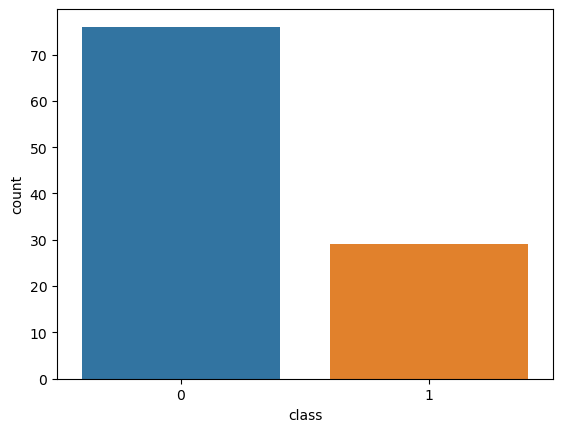

In [13]:
sns.countplot(x="class", data=test_df)

In [30]:
# Explorer data analysis per each set
def eda_set(df_set, class_dict, label_set, path_saveeda=os.path.join('./eda_figure', 'fold0')):
    print(f"{label_set}")
    txt_stat = pd.DataFrame(index=[os.path.basename(path_saveeda)])
    txt_stat['fold'] = [os.path.basename(path_saveeda)]
    txt_stat['set'] = [label_set]
    
    print('전체 학습데이터의 개수: {}'.format(len(df_set)))
    txt_stat['n_Total'] = [len(df_set)]
    train_length = df_set['context'].apply(len)
    print(f"check haed 5 : \n{train_length.head()}")
    
    plt.figure(figsize=(12, 5))
    plt.hist(train_length, bins=200, alpha=0.5, color= 'r', label='word')
    plt.yscale('log', nonpositive='clip')
    plt.title('Log-Histogram of length of conversation')
    # 그래프 x 축 라벨
    plt.xlabel('Length of conversation')
    # 그래프 y 축 라벨
    plt.ylabel('Number of conversation')
    plt.savefig(os.path.join(path_saveeda, f'lengthofconversation_{label_set}.png'), facecolor='#eeeeee',
            bbox_inches='tight', dpi=600)
    
    # printing values about length of context
    print('대화 길이 최대 값: {}'.format(np.max(train_length)))
    print('대화 길이 최소 값: {}'.format(np.min(train_length)))
    print('대화 길이 평균 값: {:.2f}'.format(np.mean(train_length)))
    print('대화 길이 표준편차: {:.2f}'.format(np.std(train_length)))
    print('대화 길이 중간 값: {}'.format(np.median(train_length)))
    # 사분위의 대한 경우는 0~100 스케일로 되어있음
    print('대화 길이 제 1 사분위: {}'.format(np.percentile(train_length, 25)))
    print('대화 길이 제 3 사분위: {}'.format(np.percentile(train_length, 75)))
    print('대화 길이 90 percentile: {}'.format(np.percentile(train_length, 90)))
    print('대화 길이 95 percentile: {}'.format(np.percentile(train_length, 95)))
    
    convs_stat = pd.DataFrame({'대화 길이 최대 값': np.max(train_length),
                                '대화 길이 최소 값': np.min(train_length),
                                '대화 길이 평균 값': np.mean(train_length),
                                '대화 길이 표준편차': np.std(train_length),
                                '대화 길이 중간 값': np.median(train_length),
                                '대화 길이 제 1 사분위': np.percentile(train_length, 25),
                                '대화 길이 제 3 사분위': np.percentile(train_length, 75),
                                '대화 길이 90 percentile': np.percentile(train_length, 90),
                                '대화 길이 95 percentile': np.percentile(train_length, 95)}, index=[os.path.basename(path_saveeda)])
    txt_stat = pd.concat([txt_stat, convs_stat], axis=1)
    # 박스플롯 생성
    plt.figure(figsize=(12, 5))
    plt.rc('font', family='NanumGothic')
    plt.boxplot(train_length,
                 labels=['counts'],
                 showmeans=True)
    plt.savefig(os.path.join(path_saveeda, f'boxplot_{label_set}.png'), facecolor='#eeeeee',
            bbox_inches='tight', dpi=600)
    
    # check word cloud
    cloud = WordCloud(font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf', width=800, height=600).generate(" ".join(df_set['context']))
    plt.figure(figsize=(20, 15))
    plt.rc('font', family='NanumGothic')
    plt.imshow(cloud)
    plt.axis('off')
    plt.savefig(os.path.join(path_saveeda, f'wordcloud_{label_set}.png'), facecolor='#eeeeee',
            bbox_inches='tight', dpi=600)
    
    # check class distribution
    plt.figure()
    plt.rc('font', family='NanumGothic')
    sns.countplot(x="class", data=df_set)
    plt.title("class distribution")
    plt.savefig(os.path.join(path_saveeda, f'countplot_{label_set}.png'), facecolor='#eeeeee',
            bbox_inches='tight', dpi=600)
    
    for name_class in class_dict.keys():
        print(f"n class {name_class}: {df_set['class'].value_counts()[class_dict[name_class]]}")
    
    
    # Counting word
    train_word_counts = df_set['context'].apply(lambda x:len(x.split(' ')))
    
    plt.figure(figsize=(15, 10))
    plt.rc('font', family='NanumGothic')
    plt.hist(train_word_counts, bins=50, facecolor='r',label=label_set)
    plt.title('Log-Histogram of word count in conversation', fontsize=15)
    plt.yscale('log', nonpositive='clip')
    plt.legend()
    plt.xlabel('Number of words', fontsize=15)
    plt.ylabel('Number of conversation', fontsize=15)
    plt.savefig(os.path.join(path_saveeda, f'wordcount_{label_set}.png'), facecolor='#eeeeee',
            bbox_inches='tight', dpi=600)
    
    
    print('대화 단어 개수 최대 값: {}'.format(np.max(train_word_counts)))
    print('대화 단어 개수 최소 값: {}'.format(np.min(train_word_counts)))
    print('대화 단어 개수 평균 값: {:.2f}'.format(np.mean(train_word_counts)))
    print('대화 단어 개수 표준편차: {:.2f}'.format(np.std(train_word_counts)))
    print('대화 단어 개수 중간 값: {}'.format(np.median(train_word_counts)))
    # 사분위의 경우는 0~100 스케일로 되어있음
    print('대화 단어 개수 제 1 사분위: {}'.format(np.percentile(train_word_counts, 25)))
    print('대화 단어 개수 제 3 사분위: {}'.format(np.percentile(train_word_counts, 75)))
    print('대화 단어 개수 90 percentile : {}'.format(np.percentile(train_word_counts, 90)))
    print('대화 단어 개수 95 percentile : {}'.format(np.percentile(train_word_counts, 95)))

    convs_stat = pd.DataFrame({'대화 단어 최대 값'     : np.max(train_word_counts),
                                '대화 단어 최소 값'    : np.min(train_word_counts),
                                '대화 단어 평균 값'    : np.mean(train_word_counts),
                                '대화 단어 표준편차'   : np.std(train_word_counts),
                                '대화 단어 중간 값'    : np.median(train_word_counts),
                                '대화 단어 제 1 사분위': np.percentile(train_word_counts, 25),
                                '대화 단어 제 3 사분위': np.percentile(train_word_counts, 75),
                                '대화 단어 90 percentile': np.percentile(train_word_counts, 90),
                                '대화 단어 95 percentile': np.percentile(train_word_counts, 95)}, index=[os.path.basename(path_saveeda)])
    txt_stat = pd.concat([txt_stat, convs_stat], axis=1)
    
    qmarks =   np.mean(df_set['context'].apply(lambda x: '?' in x)) # 물음표가 구두점으로 쓰임
    fullstop = np.mean(df_set['context'].apply(lambda x: '.' in x)) # 마침표
    capi_fst = np.mean(df_set['context'].apply(lambda x: x[0].isupper())) #  첫번째 대문자
    capitals = np.mean(df_set['context'].apply(lambda x: max([y.isupper() for y in x]))) # 대문자가 몇개
    numbers =  np.mean(df_set['context'].apply(lambda x: max([y.isdigit() for y in x]))) # 숫자가 몇개

    print('물음표가있는 질문: {:.2f}%'.format(qmarks * 100))
    print('마침표가 있는 질문: {:.2f}%'.format(fullstop * 100))
    print('첫 글자가 대문자 인 질문: {:.2f}%'.format(capi_fst * 100))
    print('대문자가있는 질문: {:.2f}%'.format(capitals * 100))
    print('숫자가있는 질문: {:.2f}%'.format(numbers * 100))
    
    return txt_stat

Total
전체 학습데이터의 개수: 1048
check haed 5 : 
0    1925
1     176
2    2202
3    2244
4     680
Name: context, dtype: int64
대화 길이 최대 값: 3406
대화 길이 최소 값: 50
대화 길이 평균 값: 876.10
대화 길이 표준편차: 535.81
대화 길이 중간 값: 784.5
대화 길이 제 1 사분위: 496.75
대화 길이 제 3 사분위: 1129.0
대화 길이 90 percentile: 1597.6000000000001
대화 길이 95 percentile: 1923.65
n class KTAS3: 753
n class KTAS4,5: 295
대화 단어 개수 최대 값: 952
대화 단어 개수 최소 값: 14
대화 단어 개수 평균 값: 239.69
대화 단어 개수 표준편차: 148.68
대화 단어 개수 중간 값: 214.0
대화 단어 개수 제 1 사분위: 132.75
대화 단어 개수 제 3 사분위: 309.25
대화 단어 개수 90 percentile : 444.30000000000007
대화 단어 개수 95 percentile : 527.5999999999999
물음표가있는 질문: 99.71%
마침표가 있는 질문: 98.85%
첫 글자가 대문자 인 질문: 0.00%
대문자가있는 질문: 1.34%
숫자가있는 질문: 1.05%


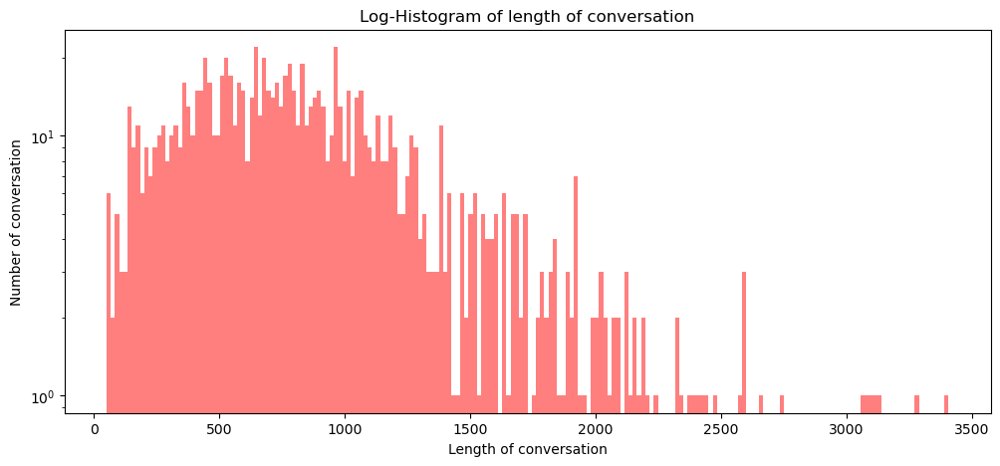

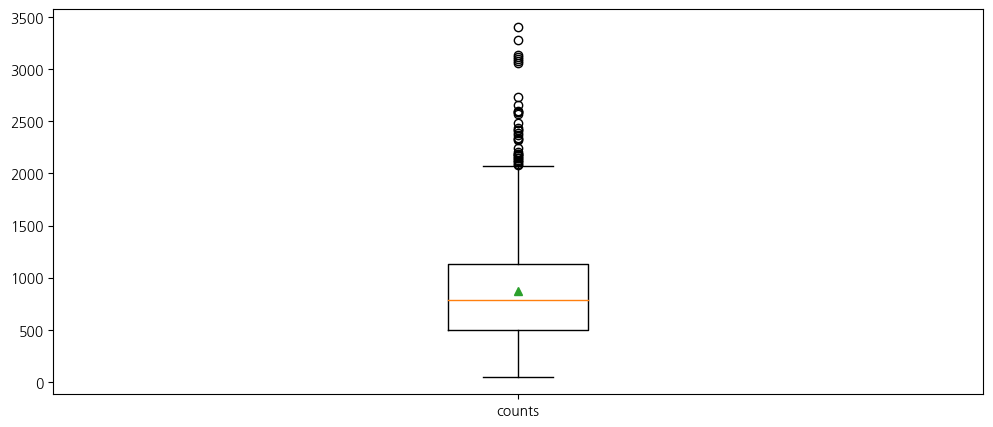

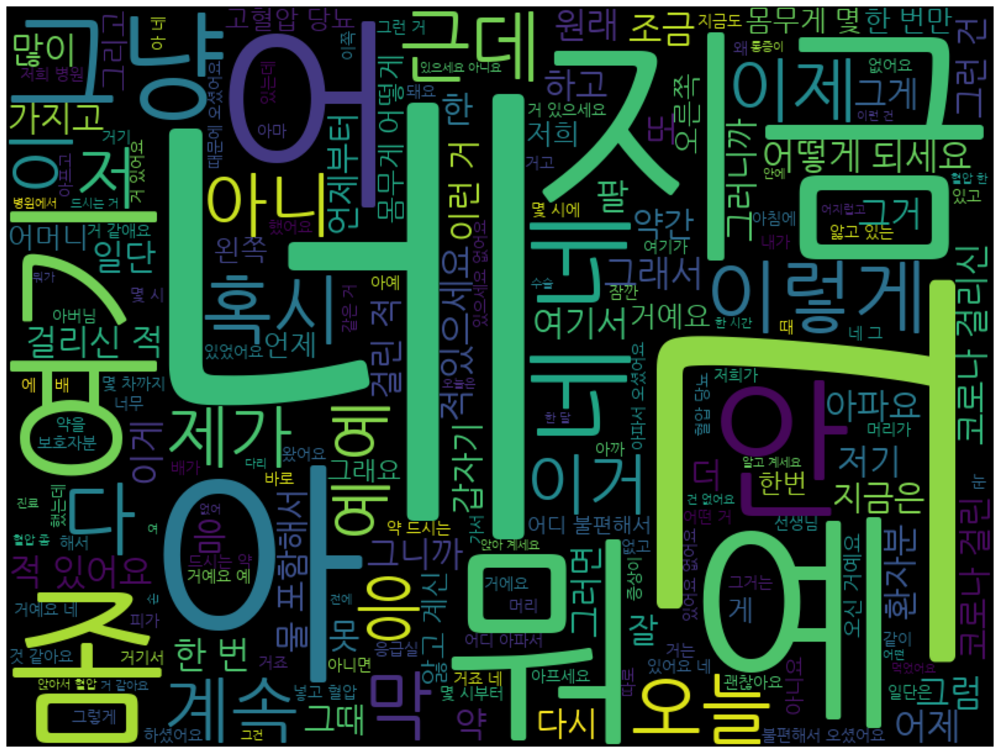

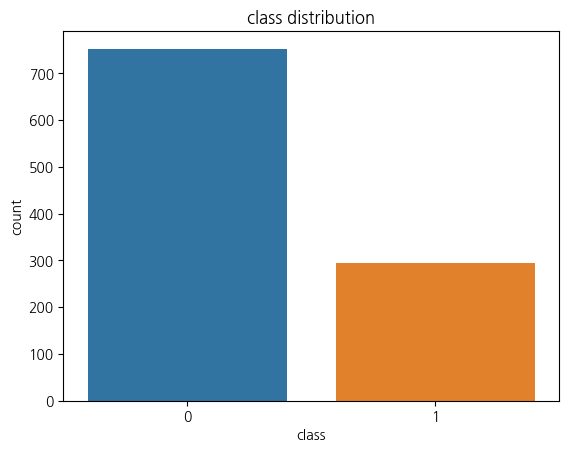

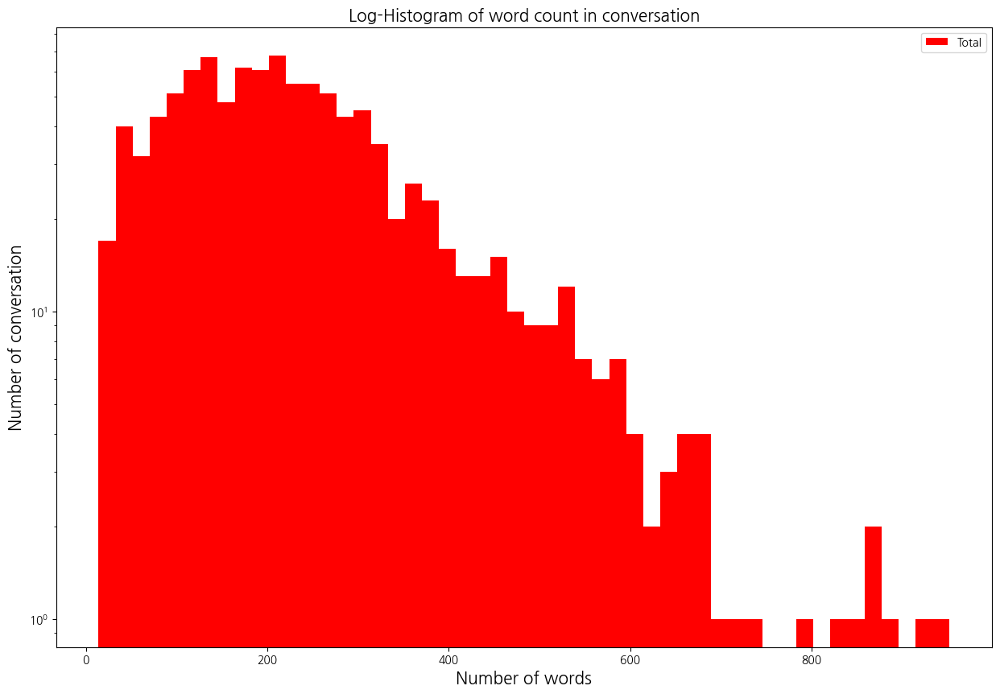

In [7]:
os.makedirs('./eda_figure/fold', exist_ok=True)
eda_set(df_all, class_dict, "Total")

Train
전체 학습데이터의 개수: 839
check haed 5 : 
0    1925
1     176
2    2202
3    2244
4     680
Name: context, dtype: int64
대화 길이 최대 값: 3406
대화 길이 최소 값: 50
대화 길이 평균 값: 870.32
대화 길이 표준편차: 538.81
대화 길이 중간 값: 772.0
대화 길이 제 1 사분위: 485.5
대화 길이 제 3 사분위: 1130.5
대화 길이 90 percentile: 1630.6000000000001
대화 길이 95 percentile: 1914.6999999999994
n class KTAS3: 602
n class KTAS4,5: 237
대화 단어 개수 최대 값: 952
대화 단어 개수 최소 값: 14
대화 단어 개수 평균 값: 238.15
대화 단어 개수 표준편차: 149.90
대화 단어 개수 중간 값: 211.0
대화 단어 개수 제 1 사분위: 129.5
대화 단어 개수 제 3 사분위: 309.0
대화 단어 개수 90 percentile : 447.20000000000005
대화 단어 개수 95 percentile : 525.3999999999996
물음표가있는 질문: 99.64%
마침표가 있는 질문: 98.93%
첫 글자가 대문자 인 질문: 0.00%
대문자가있는 질문: 1.07%
숫자가있는 질문: 1.19%
Valid
전체 학습데이터의 개수: 105
check haed 5 : 
6     761
8     639
13    871
28    611
32    351
Name: context, dtype: int64
대화 길이 최대 값: 2600
대화 길이 최소 값: 116
대화 길이 평균 값: 869.06
대화 길이 표준편차: 460.29
대화 길이 중간 값: 794.0
대화 길이 제 1 사분위: 587.0
대화 길이 제 3 사분위: 1087.0
대화 길이 90 percentile: 1451.4000000000005
대화 길이 95 per

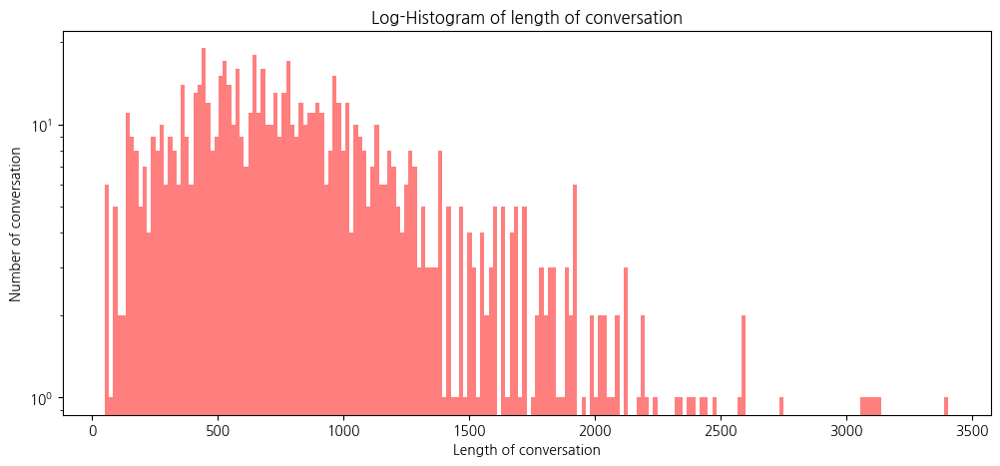

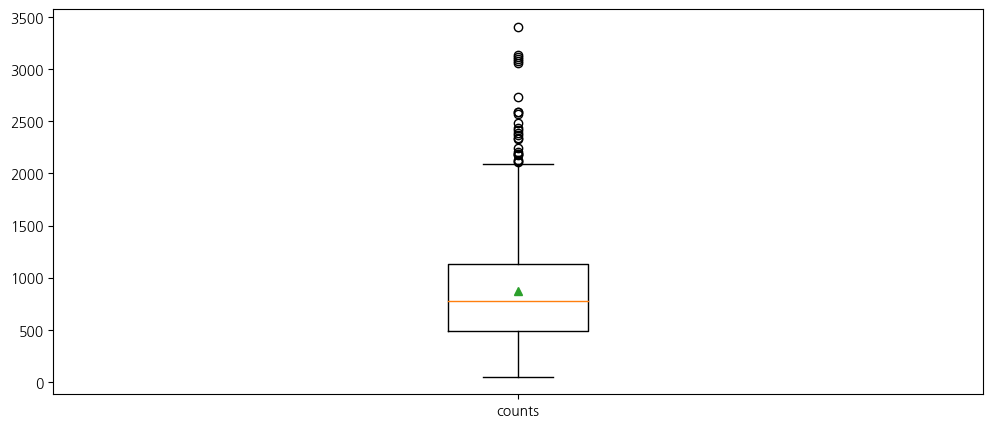

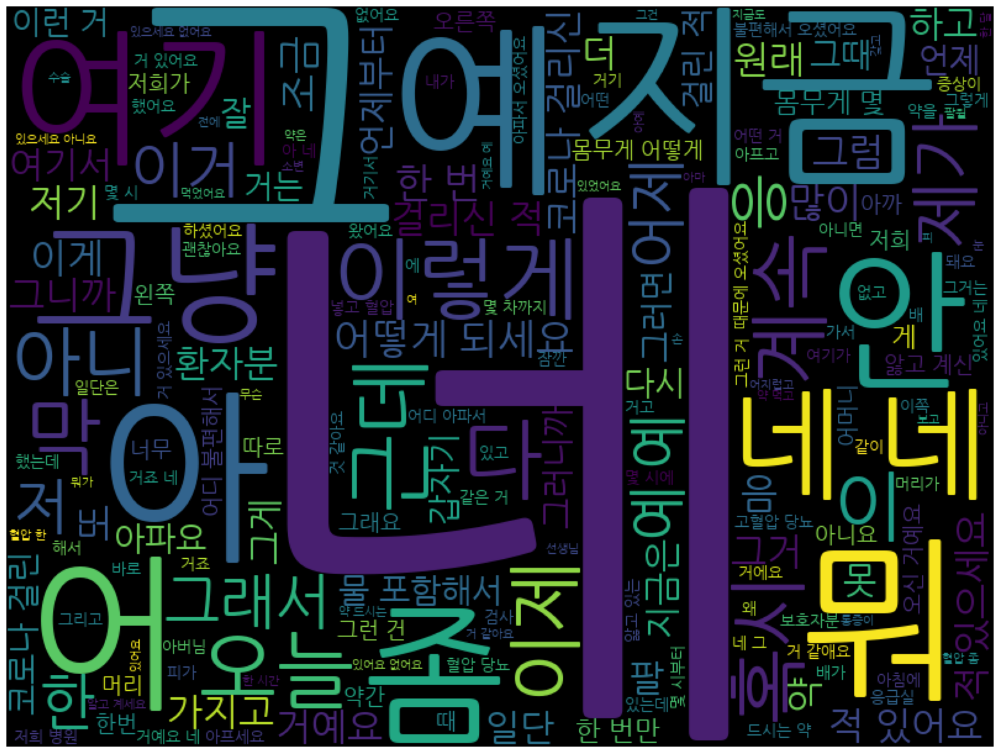

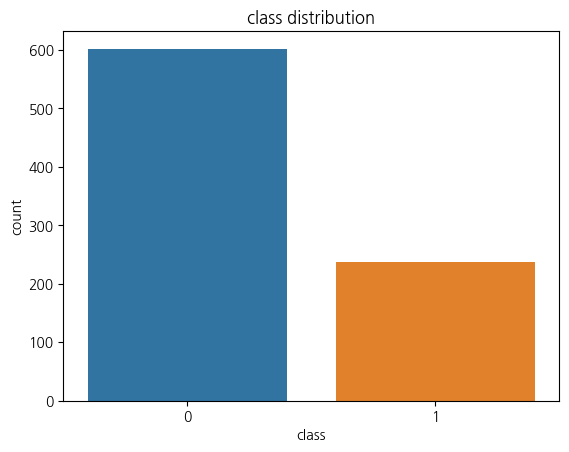

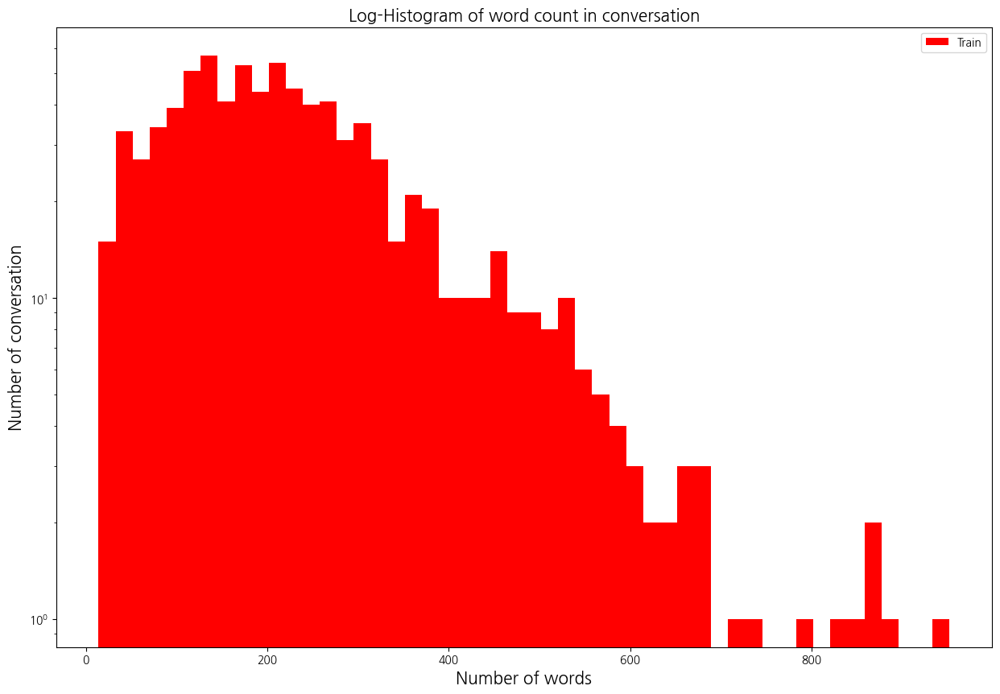

...

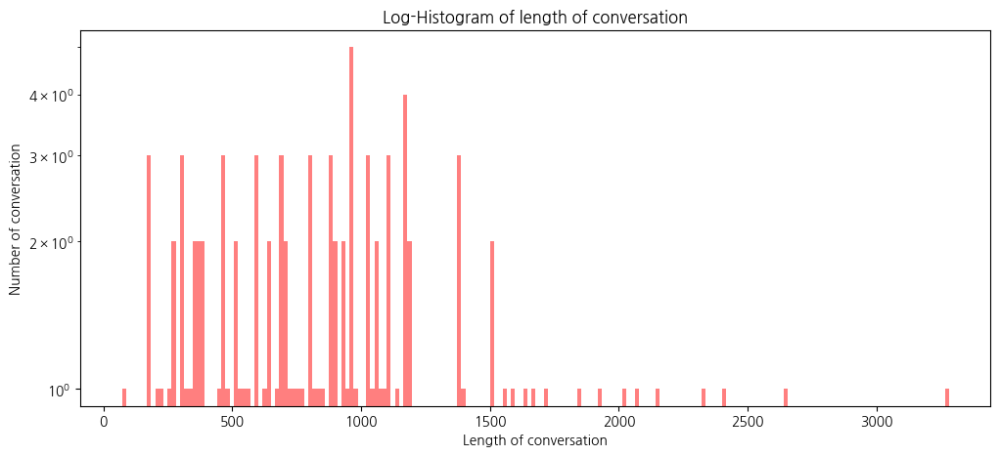

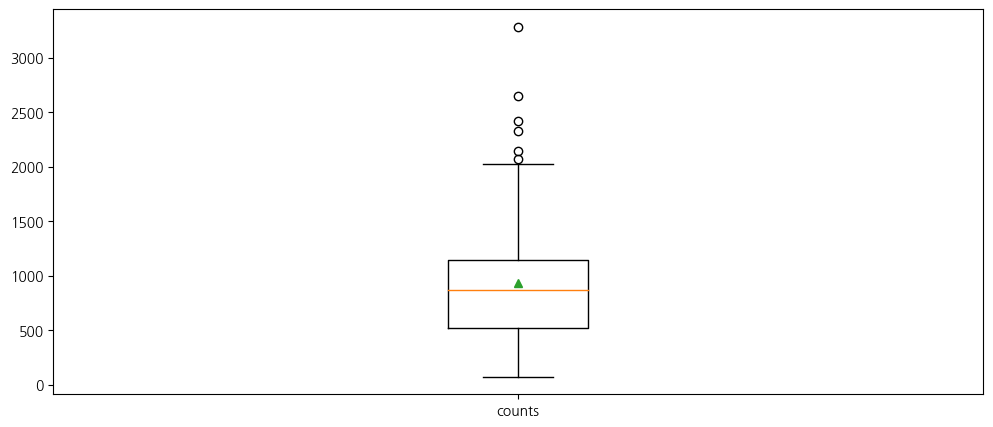

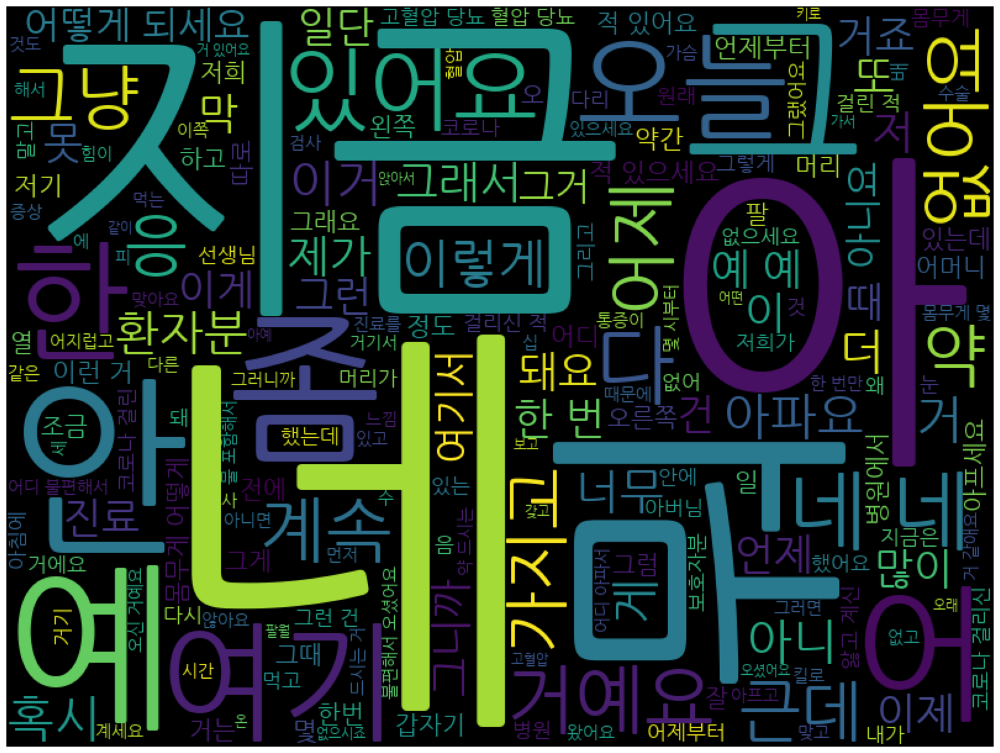

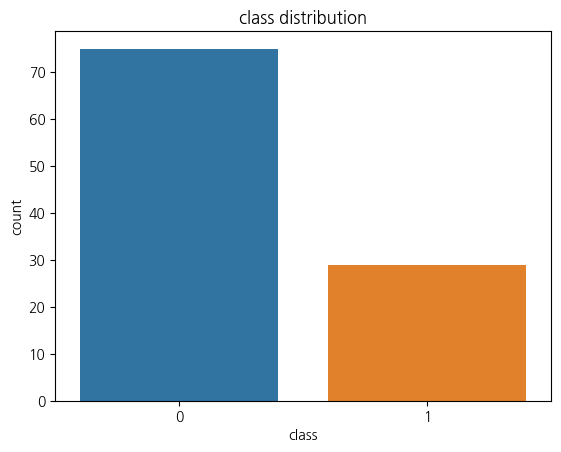

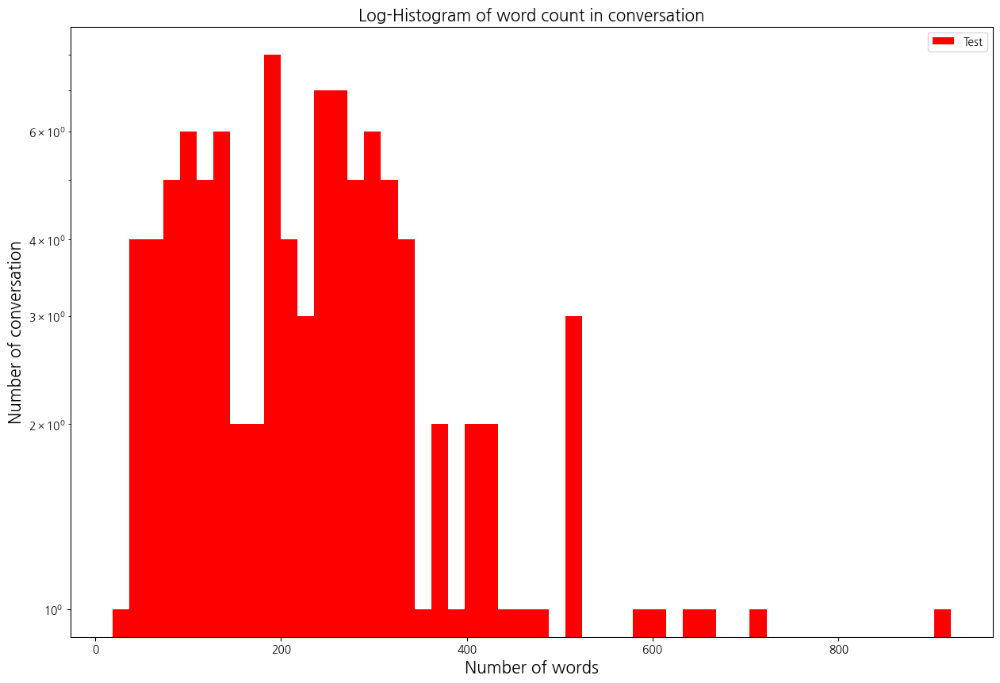

In [8]:
for df_set, label_set in zip([train_df, val_df, test_df], ["Train", "Valid", "Test"]):
    eda_set(df_set, class_dict, label_set, './eda_figure/fold')
    # print(label_set)
    # print(df_set)

fold0
N data
Train:(838,), Validation:(105,), Test:(105,)
Label shape: (838,)
Train
전체 학습데이터의 개수: 838
check haed 5 : 
0    1925
1     176
2    2244
3     680
4     781
Name: context, dtype: int64
대화 길이 최대 값: 3283
대화 길이 최소 값: 50
대화 길이 평균 값: 872.46
대화 길이 표준편차: 531.95
대화 길이 중간 값: 769.0
대화 길이 제 1 사분위: 500.5
대화 길이 제 3 사분위: 1131.25
대화 길이 90 percentile: 1581.6000000000001
대화 길이 95 percentile: 1915.0499999999997
n class KTAS3: 601
n class KTAS4,5: 237
대화 단어 개수 최대 값: 921
대화 단어 개수 최소 값: 14
대화 단어 개수 평균 값: 238.48
대화 단어 개수 표준편차: 147.35
대화 단어 개수 중간 값: 212.0
대화 단어 개수 제 1 사분위: 133.0
대화 단어 개수 제 3 사분위: 310.75
대화 단어 개수 90 percentile : 436.9000000000002
대화 단어 개수 95 percentile : 524.0
물음표가있는 질문: 99.64%
마침표가 있는 질문: 98.93%
첫 글자가 대문자 인 질문: 0.00%
대문자가있는 질문: 0.95%
숫자가있는 질문: 0.95%
        fold    set  n_Total  대화 길이 최대 값  대화 길이 최소 값  대화 길이 평균 값  대화 길이 표준편차  \
fold0  fold0  Train      838        3283          50  872.460621  531.946507   

       대화 길이 중간 값  대화 길이 제 1 사분위  대화 길이 제 3 사분위  ...  대화 길이 95 percentile 

/tmp/ipykernel_1060815/2935479743.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 5))


대화 길이 최대 값: 2736
대화 길이 최소 값: 56
대화 길이 평균 값: 882.91
대화 길이 표준편차: 527.98
대화 길이 중간 값: 760.0
대화 길이 제 1 사분위: 484.0
대화 길이 제 3 사분위: 1129.0
대화 길이 90 percentile: 1689.6000000000001
대화 길이 95 percentile: 1873.8
n class KTAS3: 76
n class KTAS4,5: 29
대화 단어 개수 최대 값: 799
대화 단어 개수 최소 값: 16
대화 단어 개수 평균 값: 243.28
대화 단어 개수 표준편차: 148.57
대화 단어 개수 중간 값: 209.0
대화 단어 개수 제 1 사분위: 134.0
대화 단어 개수 제 3 사분위: 312.0
대화 단어 개수 90 percentile : 470.60000000000014
대화 단어 개수 95 percentile : 523.8
물음표가있는 질문: 99.05%
마침표가 있는 질문: 98.10%
첫 글자가 대문자 인 질문: 0.00%
대문자가있는 질문: 2.86%
숫자가있는 질문: 2.86%
        fold    set  n_Total  대화 길이 최대 값  대화 길이 최소 값  대화 길이 평균 값  대화 길이 표준편차  \
fold1  fold1  Valid      105        2736          56  882.914286  527.981477   

       대화 길이 중간 값  대화 길이 제 1 사분위  대화 길이 제 3 사분위  ...  대화 길이 95 percentile  \
fold1       760.0          484.0         1129.0  ...               1873.8   

       대화 단어 최대 값  대화 단어 최소 값  대화 단어 평균 값  대화 단어 표준편차  대화 단어 중간 값  \
fold1         799          16   243.27619  148.568951       2

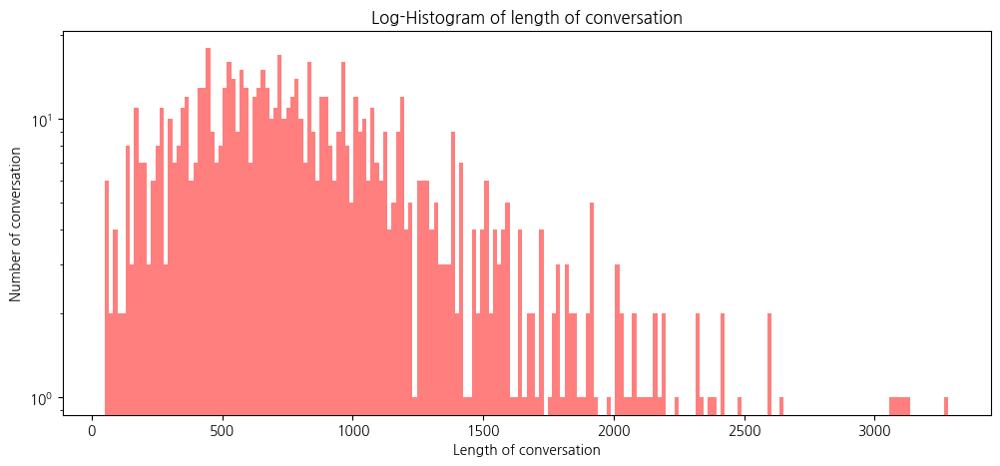

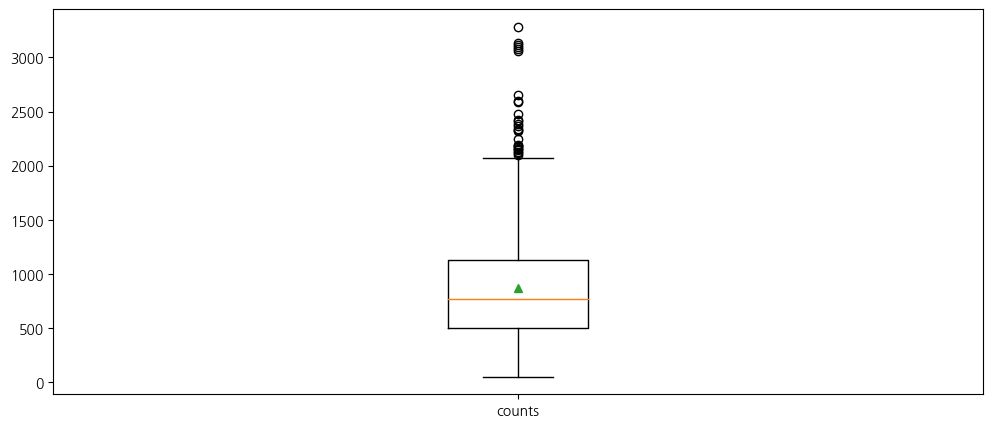

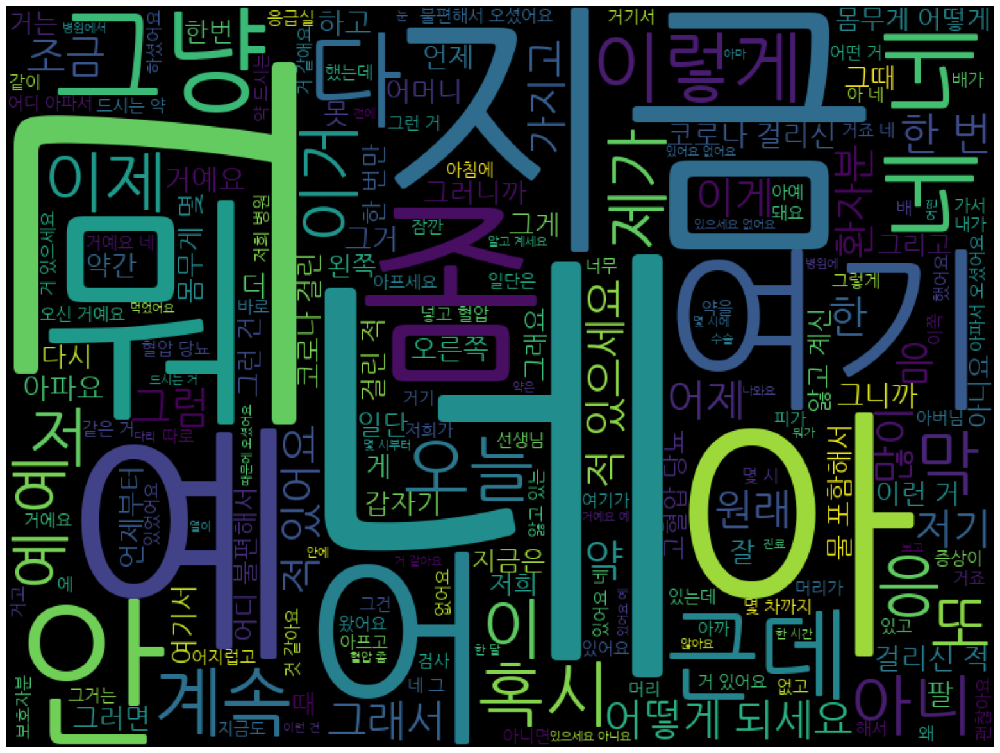

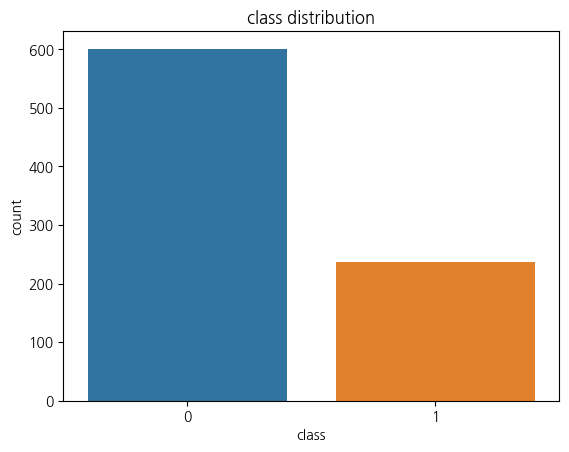

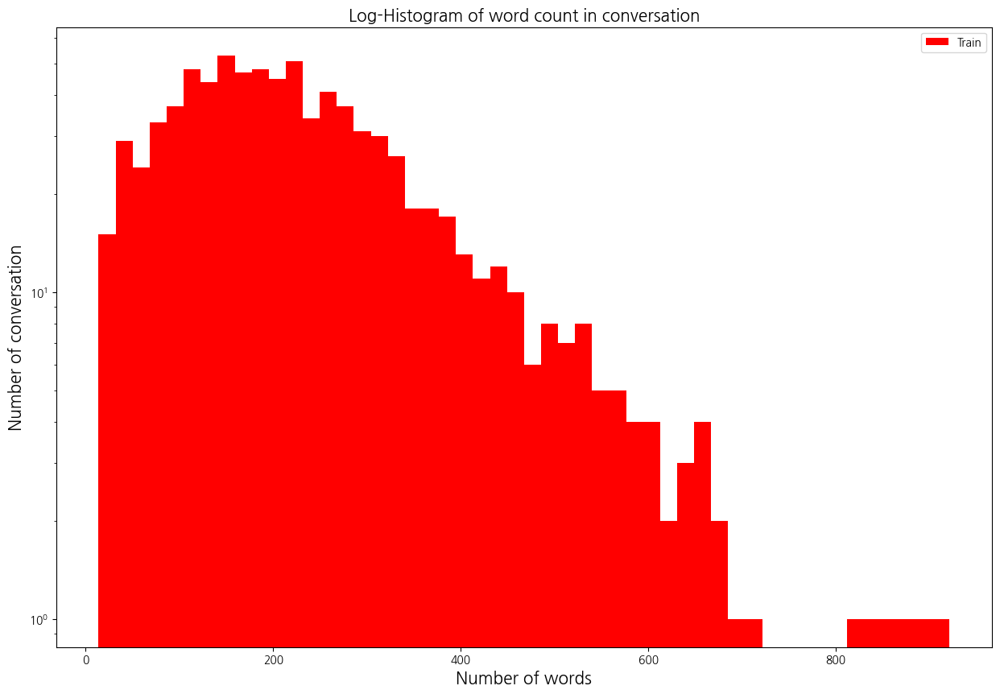

...

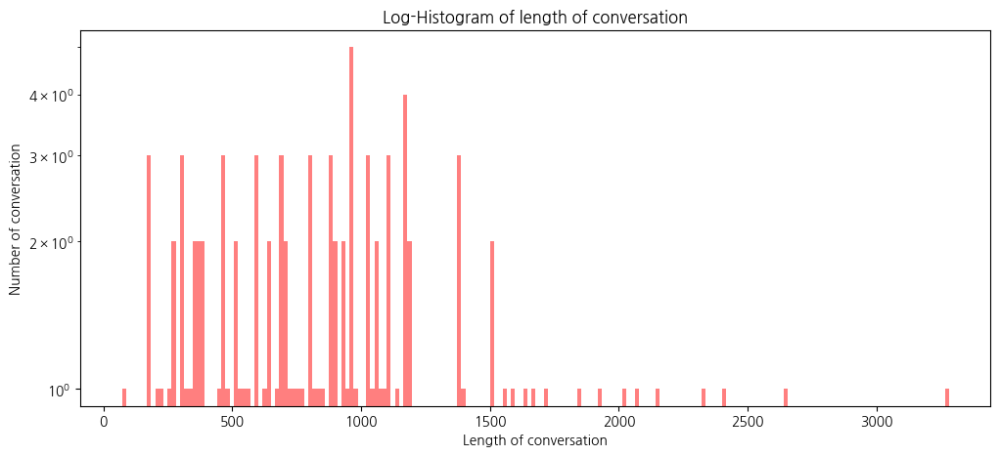

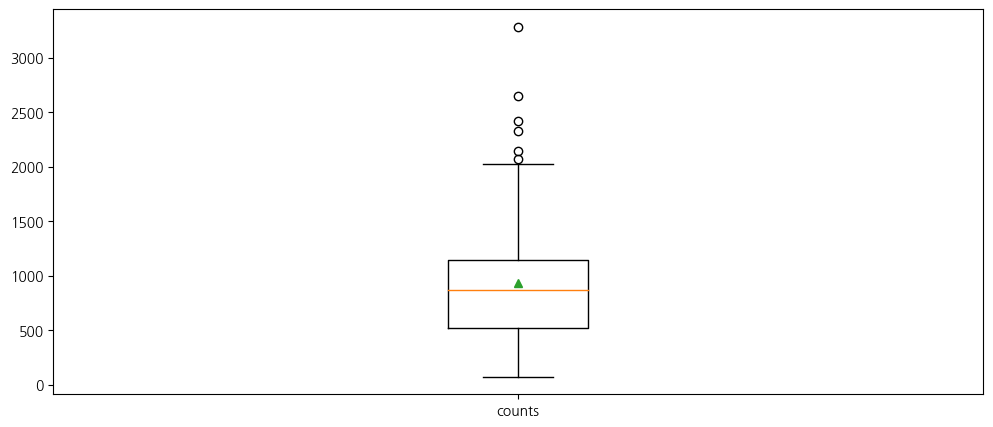

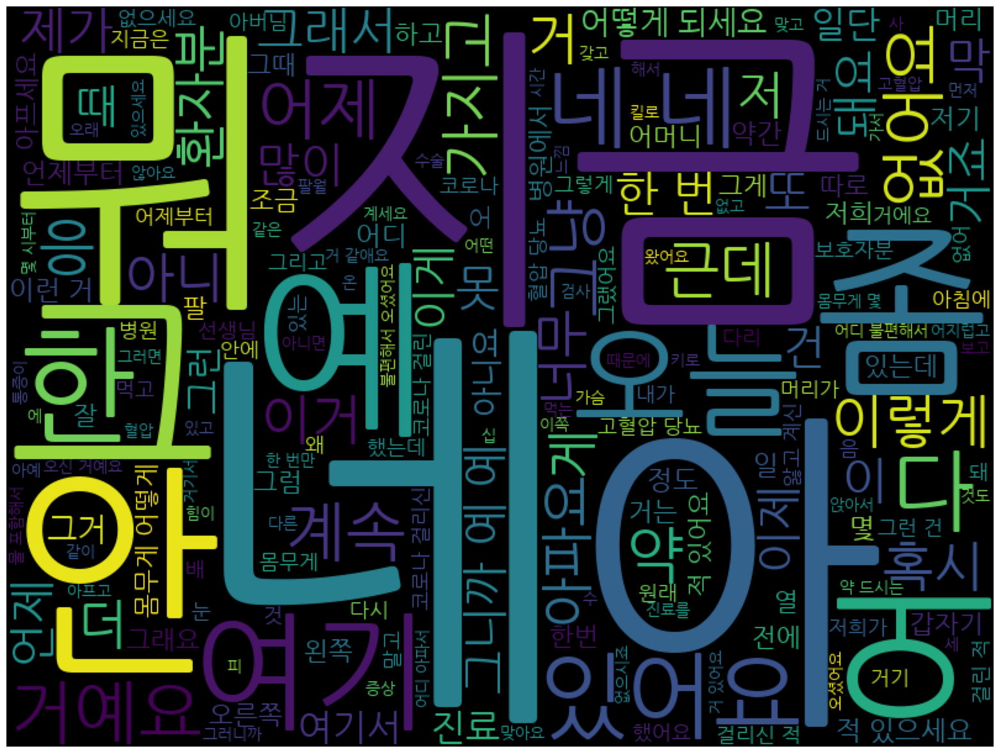

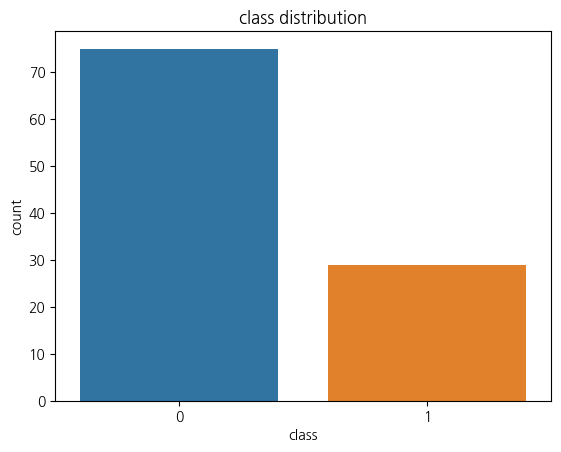

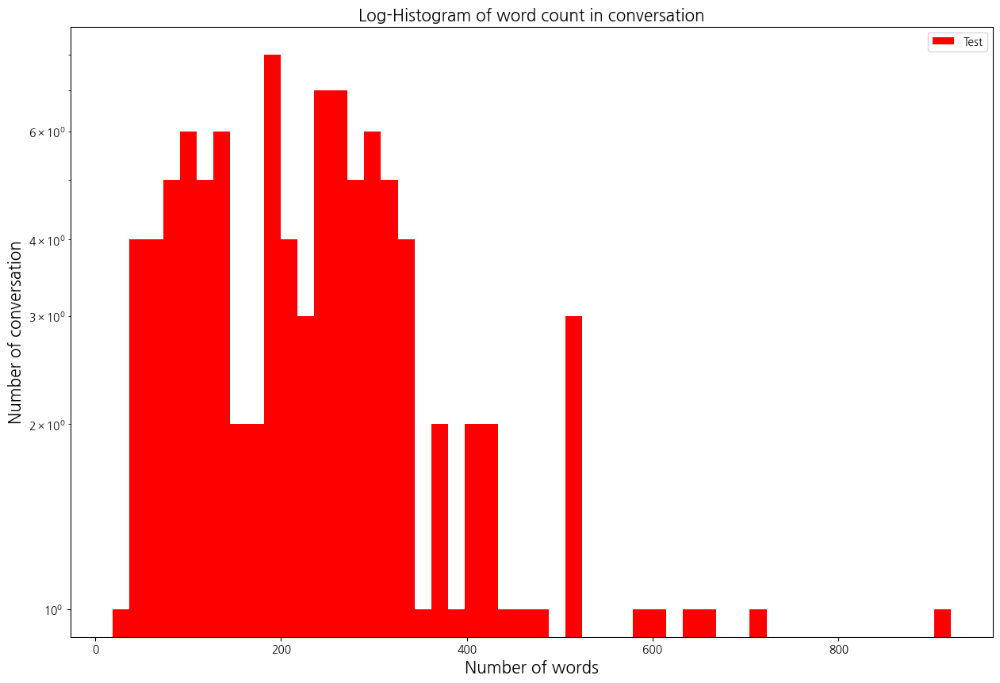

In [31]:
get_edaNprep = _get_edaNprep(df_all = df_all, class_dict = class_dict, configs = configs)
txt_stat = pd.DataFrame()
# print(k)
for k in range(0, configs["n_fold"]):
# for k in range(0, 1):
    print(f'fold{k}')
    _, _, _, _, _, _, _, _, _, train_df, val_df, test_df = get_edaNprep._data_split(k = k)
    path_saveeda=os.path.join('./eda_figure', f'fold{k}')
    os.makedirs(path_saveeda,  exist_ok=True)
    for df_set, label_set in zip([train_df, val_df, test_df], ["Train", "Valid", "Test"]):
        sub_stat = eda_set(df_set, class_dict, label_set,path_saveeda)
        print(sub_stat)
        txt_stat = pd.concat([txt_stat, sub_stat], axis=0)
        
txt_stat.to_excel(os.path.join('./eda_figure', f'txt_statistics.xlsx'))